# ბიბლიოთეკების დაიმპორტება

In [1]:
!pip install swig pygame -q
!pip install gymnasium[box2d] -q
!pip install gym==0.26.2 -q
!pip show gym

Name: gym
Version: 0.26.2
Summary: Gym: A universal API for reinforcement learning environments
Home-page: https://www.gymlibrary.dev/
Author: Gym Community
Author-email: jkterry@umd.edu
License: MIT
Location: /home/slowtdancer/miniconda3/lib/python3.11/site-packages
Requires: cloudpickle, gym-notices, numpy
Required-by: 


In [2]:
import gym
import random
import numpy as np
from PIL import Image
import cv2
import os
from datetime import datetime
from matplotlib import pyplot as plt
%matplotlib inline
import warnings
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import torchvision.transforms as transforms
from torch.distributions import Beta
from torch.utils.data.sampler import BatchSampler, SubsetRandomSampler
from collections import deque

# ჰიპერპარამეტრები და კონსტანტები

თითოეულ ცვლადზე ვილაპარაკებთ შემდგომში რა რატომ არის ეგრე, მაგრამ აქვე აღვნიშნავ, რომ ჩვენ dqnის იმპლემენტაციას დავწერთ pytorchით, რომელსაც სხვანაირი თანმიმდევრობით გადაეცემა მდგომარეობა და ასევე დავამუშავებთ კადრებს, რის მერეც RGBის მაგივრად GRAYSCALE კადრები გვექნება.

In [3]:
STATE_SHAPE = (1, 96, 96)
NUM_ACTIONS = 5
TIME_TO_LOAD_STATE = 50
BUFFER_CAPACITY = 10000
BATCH_SIZE = 64
DISCOUNT_FACTOR = 0.99
LEARNING_RATE = 0.00003
INIT_EPSILON = 1.0
MIN_EPSILON = 0.1
TARGET_UPDATE_STEPS = 50
MAX_EPISODES = 3000
EPISODE_DURATION = 1000
SKIP_FRAMES = 3
MIN_XP_TO_UPDATE = 64
STEPS_FOR_UPDATE = 5
EPSILON_DECAY = 0.9985
MAX_LOSING_STREAK = 20
TEST_EPISODE = 100

# მრბოლელი მანქანის გარემო

observation space შედგება 96x96 RGB პიქსელებისგან, სადაც ნაწილი გარემოს არის გზა, ხოლო ნაწილი ბალახი. მანქანაც და სხვა არასაჭირო რაღაცებიც ჩანს ჩვენი ამოცანისთვის, მაგრამ მოდელის გამარტივების მიზნით მაგ ყველაფერს კადრების დამუშავების დროს მოვაშორებთ და ავხსნით მაგ ყველაფერს. action spaceისთვის კიდევ მოცემული ამოცანის შემთხვევაში შეგვეძლო აგვერჩია, დისკრეტული ყოფილიყო ის თუ უწყვეტი. დისკრეტულის შემთხვევაში 5 action გვქონდა: არაფრის გაკეთება, მარცხნივ მოხვევა, მარჯვნივ მოხვევა, წინ წასვლა, გამუხრუჭება; ხოლო უწყვეტის შემთხვევაში 3 გვაქვს: მოხვევა (-1 სულ მარცხნივ მოხვევა, +1 სულ მარჯვნივ მოხვევა), წინ წასვლა და დამუხრუჭება. **ჩვენი მიზანია, რომ ამ მანქანამ სიარული ისწავლოს და გზას რაც შეიძლება ნაკლებად გადაუხვიოს.**

# მოდელის არჩევა

მოდელის შერჩევა ერთ–ერთი ყველაზე რთული პროცესი აღმოჩნდა ჩემთვის. კერძოდ, თავდაპირველად ვაპირებდი, რომ DDPGით დამეწერა, რადგან ამოცანაში შეგვიძლია ავირჩიოთ დისკრეტული action space გვექნება თუ უწყვეტი და სურვილი მქონდა, რომ უწყვეტით დამეწერა. იმპლემენტაცია დავწერე და მუშაობდა, მაგრამ გატესტვას უაზროდ დიდი დრო სჭირდება დაახლოებით ერთ ეპიზოდს აკეთებდა ერთი წუთში (დავამატებ, რომ Kaggleზე ვწერდი ამ ყველაფერს), და როდესაც პირველი გაშვებაზე დიდი პროგრესი ვერ ვნახე ვივარაუდე, რომ თუ რამეს ისწავლიდა მერე უფრო დიდი დრო დასჭირდებოდა ამ ყველაფერს. შესაბამისად, გადავწყვიტე, რომ ორი იმპლემენტაცია დამეწერა DQNით და PPOთი, რადგან თავი დამეზღვია თუ PPO არ იმუშავებდა და თან თუ იმუშავებდა უწყვეტისთვის მქონოდა ცალკე ამოხსნა. DQN დისკრეტულ შემთხვევაში ნორმალურად იმუშავებდა, თან ამავდროულად უწყვეტის შემთხევაშიც შეგვიძლია რაღაცა ხერხებით მოვახერხოთ და მაინც ავამუშავოთ, ხოლო PPOზე მოძიების დროს შემხვდა, რომ კოდის მხრივ ერთ–ერთი ყველაზე მარტივი დასაწერია და რადგანაც ორი მოდელით დაწერა მინდოდა და შემდეგ მათი კომბინაცია გადავწყვიტე.

## გარემოს ჩატვირთვა

In [4]:
warnings.filterwarnings('ignore')
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3'
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
env = gym.make('CarRacing-v2', render_mode='rgb_array', continuous=True)

# როდის უნდა დავიწყოთ დაკვირვება და ტრენინგი?

საიტის გახსნისთანავე GIFზე ჩანს, რომ თამაშის დასაწყისში კამერა შორს იმყოფება და ნელ–ნელა უახლოვდება მას,  და რამდენიმე გაშვების შემდეგ 50 კადრში სადღაც მიახლოებული იყო ხოლმე, ამის გამო ტრენინგიც და კადრებზე დაკვირვებაც რომ დავიწყოთ 50ე კადრიდან კარგი ვარიანტი მგონია.

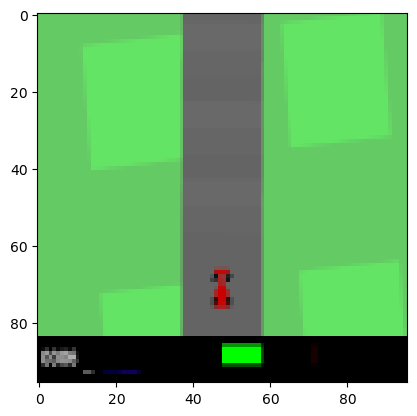

In [5]:
test_state = env.reset()[0]
for _ in range(TIME_TO_LOAD_STATE):
    action = np.random.uniform(low=env.action_space.low, high=env.action_space.high, size=env.action_space.shape)
    test_state = env.step(action)[0]
alpha_state = Image.fromarray(test_state)
plt.imshow(alpha_state)

## კადრების დამუშავება

ImageProcessor იქნება ჩვენი კადრების დამმუშავებელი კლასი, რომელიც უკვე ქვემოთ იმპლემენტირებულია. ნაბიჯ–ნაბიჯ უკეთესად გავარჩევ და ვიტყვი, თუ თითოეული ნაწილი რას აკეთებს.

In [6]:
class ImageProcessor:
    def __init__(self, state):
        self.state = state
        self.green_mask = [0.0, 1.0, 0.0]
        self.MAX_GREEN = 200

    def process(self):
        self.remove_junk()
        self.clean_color()
        self.blur()
        self.edge_detector()

    def remove_junk(self):
        hsv = cv2.cvtColor(self.state, cv2.COLOR_BGR2HSV)
        mask_green = cv2.inRange(hsv, (36, 25, 25), (70, 255,255))

        imask_green = mask_green>0
        green = np.zeros_like(self.state, np.uint8)
        green[imask_green] = self.state[imask_green]

        self.state = (green)

    def clean_color(self):
        self.state = np.dot(self.state[...,:3], self.green_mask)
        self.state = np.clip(self.state, a_min=0, a_max=self.MAX_GREEN)

    def blur(self):
        self.state = cv2.GaussianBlur(self.state, (5, 5), 0)

    def edge_detector(self):
        temp_state = np.uint8(self.state)
        self.state = cv2.Canny(temp_state, 1, 100)
        self.state = np.expand_dims(self.state, axis=2)

    def get_state(self):
        return self.state

    def set_state(self, state):
        self.state = state

In [7]:
image_processor = ImageProcessor(test_state)

### პირველი
კადრებს თუ კარგად დავაკვირდებით, მოსახვევებში ხშირად ვხვდებით არ ვიცი ზუსტად რა ჰქვია, მაგრამ წითელ–თეთრ რაღაცებს, რომელიც ჩვენ დიდად არაფერში გვაინტერესებს და კომპლექსურს ხდის უფრო გარემოს, ასევე უნდა ითქვას, რომ მანქანაც რომ ჩანდეს კადრებში ეგეც არაა საჭირო, რადგან მანქანისთან მიმართებით მოძრაობს კამერაც და მაქედანაც შესაძლებელია მიხვედრა მანქანა სად არის და ისევ გარემოს გასამარტივებლად მაგასაც ვშლი.

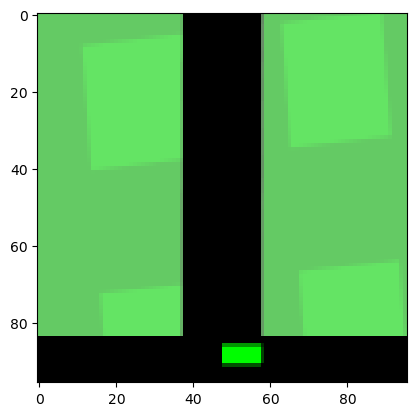

In [8]:
image_processor.remove_junk()
beta_state = Image.fromarray(np.squeeze(image_processor.get_state()))
plt.imshow(beta_state)

### მეორე
ასევე შეგვიძლია, რომ მწვანის მაგივრად შავ–თეთრად შევხედოთ გარემოს და RGBის მაგივარად GRAYSCALE გვქნება, რაც ასევე ამარტივებს გარემოს და შედეგზე გავლენას არ იქონიებს.

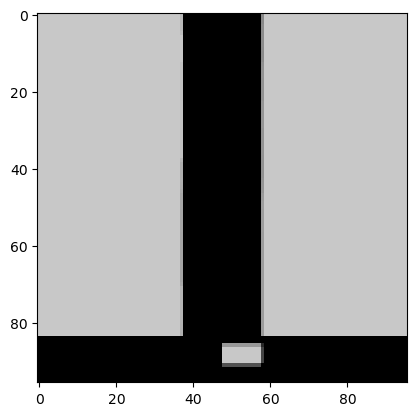

In [9]:
image_processor.clean_color()
beta_state = Image.fromarray(np.squeeze(image_processor.get_state()))
plt.imshow(beta_state)

### მესამე
ახლა გაუსის blurს გამოვიყენებ, რადგან overfittingს ამცირებს და სურათის ხმაურს ზოგადად, მაგრამ ამ შემთხვევაში ჩვენთვის მნიშვნელოვნია, რომ გზა კარგად ამოვიღოთ, რის გამოც წიბოები კარგად უნდა ჩანდეს და ხშირ შემთხვევაში [წყარო](http://https://towardsai.net/p/machine-learning/gaussian-blurring-a-gentle-introduction) როგორც აქაა ახსნილი და ნაჩვენები ბევრად უკეთესს ხდის ეს ამ ყველაფერს

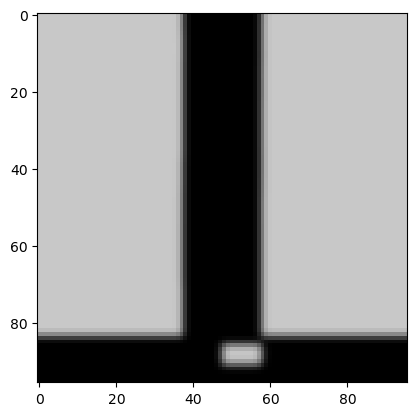

In [10]:
image_processor.blur()
beta_state = Image.fromarray(np.squeeze(image_processor.get_state()))
plt.imshow(beta_state)

### მეოთხე
ახლა კიდევ შეგვიძლია, რომ წიბოების გარკვევის cannyის ალგორითმი გავუშვათ, რომ გზა უკეთესად აღვიქვათ და შევისწავლოთ. მეტი ინფორმაციისთვის შეგიძლიათ იხილოთ [წყარო](https://en.wikipedia.org/wiki/Canny_edge_detector). P.S. ვერ გავიგე რატომ აფერადებს იასამნისფად და ყვითლად, მაგრამ ბოლოს კიდევ ერთხელ მაინც დავრწმუნდებით, რომ GRAYSCALEში გადავიყვანეთ ყველაფერი.

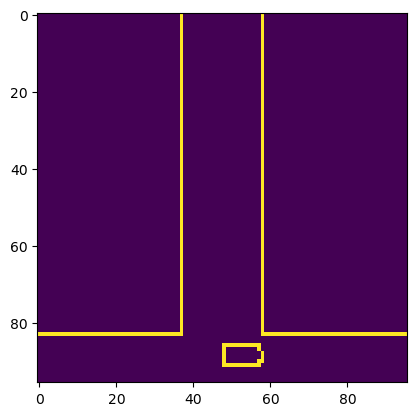

In [11]:
image_processor.edge_detector()
beta_state = Image.fromarray(np.squeeze(image_processor.get_state()))
plt.imshow(beta_state)

# მოდელი - Deep Q-Learning

როგორც უკვე ზემოთ ვახსენე გადავწყვიტე, რომ მოდელად გამოვიყენო Deep Q-Learningის ალგორითმი. ახლა მოკლედ ვიტყვი რა ძირათდი კომპონენტებისგან შედგება  dqn და შემდეგ ნელ–ნელა იმპლემენტაციის ნაწილში უფრო დეტალურად განვიხილავთ ამ ყველაფერს.


1.   Q-network: ნეირონული ქსელი რომელსაც გადაეცემა მდგომარეობა და აბრუნებს q-valueებს ყველა შესაძლო actionისთვის
2.   Experience Replay: bufferია რომელიც ინახავს ძველ გამოცდილებებს რა რანდომზე ირჩევს მათ ტრენინგის დროს.
3.   Target Network: q-networkია, რომელიც target q-valueებს ითვლის.

ასევე, მე გამომადგა ეს [წყარო](https://towardsdatascience.com/how-does-a-dqn-approximate-bellmans-equation-53e591d5e33) ალგორითმის უკეთ გასაგებად და აქ უფრო დეტალურადაა ახსნილი ყველაფერი.






## მოქმედებების დისკრეტიზაცია

როგორც ვთქვით, dqn მუშაობს მხოლოდ მუშაობს დისკრეტული action spaceისთვის, მაგრამ ეს ჩვენს ამოხსნას არ აბათილებს უწყვეტის შემთხვევაში, რადგან თუ უწყვეტი გარემო გვექნება შეგვიძლია, რომ მოქმედებებს დისკრეტიზაცია გავუკეთოთ და შემდეგ დისკრეტულ ამოცანაზე დავიყვანოთ.

In [12]:
class DiscretizedActionWrapper(gym.ActionWrapper):
    def __init__(self, env):
        super(DiscretizedActionWrapper, self).__init__(env)
        self.action_space = gym.spaces.Discrete(NUM_ACTIONS)
        self._actions = {
            0: np.array([0.0, 0.0, 0.0]),   # არაფრის გაკეთება
            1: np.array([-1.0, 0.0, 0.0]),  # მარცხნივ მოხვევა
            2: np.array([1.0, 0.0, 0.0]),   # მარჯვნივ მოხვევა
            3: np.array([0.0, 1.0, 0.0]),   # წინ წასვლა
            4: np.array([0.0, 0.0, 0.8])    # დამუხრუჭება
        }

    def action(self, action):
        return self._actions[action]

## იმპლემენტაცია

In [13]:
env = gym.make('CarRacing-v2', render_mode='rgb_array', continuous=False)

### Experience Replay

ზერელედ უკვე შევეხეთ experience replayის, მაგრამ მოდი ახლა უფრო კარგად ავხსნათ, თუ რატომ გვჭირდება ის და რაში ვიყენებთ. იგი გამოიყენება იმისთვის, რომ აგენტის წინა გამოცდილებები შევინახოთ, რათა შემდეგ დასწავლაში გამოვიყენოთ. ასევე, მნიშნველოვანია ReplayBufferის sample მეთოდი, რადგან ის ბოლო შენახული გამოცდილებებიდან რანდომად არჩევს რამდენიმეს და მაგის საშუალებით სწავლობს და არა წინა რამდენიმე გამოცდილებებიდან, რაც უფრო overfittingს ამცირებს. ამ ყველაფრის გასააზრებლად მე გამომადგა [წყარო](https://datascience.stackexchange.com/questions/20535/what-is-experience-replay-and-what-are-its-benefits).

In [14]:
class ReplayBuffer:
    def __init__(self, capacity):
        self.buffer = deque(maxlen=capacity)

    def store(self, experience):
        self.buffer.append(experience)

    def sample(self, batch_size):
        batch_size = min(batch_size, len(self.buffer))
        sampled_experiences = random.sample(self.buffer, batch_size)
        return np.array(sampled_experiences, dtype=object)

    def __len__(self):
        return len(self.buffer)

### ნეირონული ქსელი

ეს ჩვენი ნეირონული ქსელია, რომელსაც როგორც ვთქვით 1 ჩენელი აქვს, რადგან კადრების დამუშავების შემდეგ ეგეთ გარემოს მივიღებთ.

In [15]:
class DQN(nn.Module):
    def __init__(self, num_actions):
        super(DQN, self).__init__()
        self.conv1 = nn.Conv2d(1, 12, kernel_size=6, stride=4)
        self.pool = nn.MaxPool2d(2, 2)
        self.conv2 = nn.Conv2d(12, 24, kernel_size=4)
        self.fc1 = nn.Linear(24*4*4, 256)
        self.fc2 = nn.Linear(256, 128)
        self.fc3 = nn.Linear(128, num_actions)

    def forward(self, x):
        x = torch.relu(self.conv1(x))
        x = self.pool(x)
        x = torch.relu(self.conv2(x))
        x = self.pool(x)
        x = x.view(x.size(0), -1)
        x = torch.relu(self.fc1(x))
        x = torch.relu(self.fc2(x))
        x = self.fc3(x)
        return x

### ხარბი εის ალგორითმი

იმისთვის, რომ მოდელს საშუალება მივცეთ, რომ ახალი გამოცდილება დააგროვოს და რაღაცას კარგად რომ "დაამუღამებს" მერე მარტო ეგ არ აკეთოს, კარგი იქნება, თუ ხარბი εის ალგორითმს გამოვიყენებთ, რომელიც მდგომარეობს შემდეგში, რომ მოდელი ε ალბათობით ნებისმიერ რაღაცას გააკეთებს და 1–ε ალბათობით საუკეთესო გადაწყვეტილებას მიიღებს. ამავდროულად რაც უფრო მეტი დრო გავა მით უფრო აღარაა საჭირო, რომ ახალი actionები გამოვიკვლიოთ, რის გამოც ნელ–ნელა შევამცირებთ εს, რადგან actionის არჩევა წერია DPG კლასში მანდ choose_action მეთოდი დავააფდეითე რომ გამოგვეყენებინა ზემოთხსენებული და ასევე decay მეთოდი გვაქვს, რომ ექსპონენციაულრად შევამციროთ ეფსილონი ყოველი ეპიზოდის მერე. მეტი ინფორმაციისთვის იხილეთ [წყარო](https://www.youtube.com/watch?v=z6-Cz-pElGA).

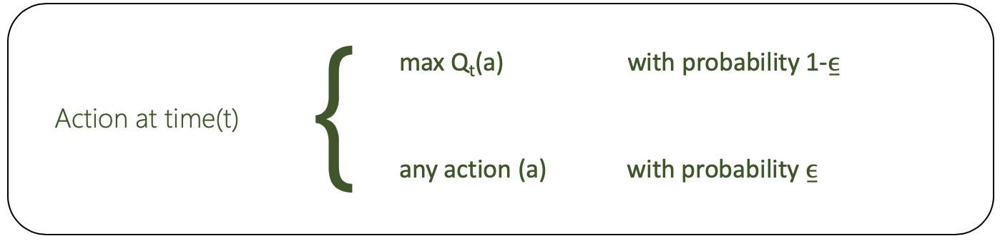

### აგენტი

აქ კი უკვე ზემოთახსნილი მეთოდების საშუალებით არის დაიმპლემენტირებული DQNAgent.

In [16]:
class DQNAgent:
    def __init__(self, q_network, target_q_network, num_actions=NUM_ACTIONS, lr=LEARNING_RATE, epsilon=INIT_EPSILON,
                epsilon_decay=EPSILON_DECAY, epsilon_min=MIN_EPSILON,
                buffer_capacity=BUFFER_CAPACITY, discount_factor=DISCOUNT_FACTOR,
                batch_size=BATCH_SIZE):
        self.q_network = q_network
        self.target_q_network = target_q_network
        self.target_q_network.load_state_dict(self.q_network.state_dict())
        self.target_q_network.eval()
        self.optimizer = optim.Adam(self.q_network.parameters(), lr=lr)
        self.epsilon = epsilon
        self.epsilon_decay = epsilon_decay
        self.epsilon_min = epsilon_min
        self.memory = ReplayBuffer(buffer_capacity)
        self.discount_factor = discount_factor
        self.batch_size = batch_size
        self.loss_fn =  nn.MSELoss()

    def store(self, experience):
        self.memory.store(experience)

    def best_action(self, state):
        state = torch.FloatTensor(state).unsqueeze(0).to(device)
        q_values = self.q_network(state)
        return torch.argmax(q_values).item()

    def choose_action(self, state, learn=True):
        if learn and np.random.rand() <= self.epsilon:
            action = random.randrange(NUM_ACTIONS)
        else:
            action = self.best_action(state)

        return action

    def decay(self):
        self.epsilon = max(self.epsilon * self.epsilon_decay, self.epsilon_min)

    def train_step(self):
        batch = self.memory.sample(self.batch_size)
        states, actions, rewards, next_states, dones = zip(*batch)

        states = torch.stack([torch.FloatTensor(state) for state in states]).to(device)
        next_states = torch.stack([torch.FloatTensor(next_state) for next_state in next_states]).to(device)

        actions = torch.LongTensor(actions).to(device)
        rewards = torch.FloatTensor(rewards).to(device)
        dones = torch.FloatTensor(dones).to(device)

        with torch.no_grad():
            next_q_values = self.target_q_network(next_states)
            max_next_q_values = torch.max(next_q_values, dim=1)[0]
            target_q_values = rewards + (self.discount_factor * max_next_q_values * (1 - dones))

        q_values = self.q_network(states)
        q_values = q_values.gather(1, actions.unsqueeze(1)).squeeze(1)

        loss = self.loss_fn(q_values, target_q_values.detach())

        self.optimizer.zero_grad()
        loss.backward()
        self.optimizer.step()

## ტრენინგი

### ტრენინგისთვის დამხმარე ფუნქციები

In [17]:
def filter_state(state, image_processor):
    image_processor.set_state(state)
    image_processor.process()

    transform = transforms.Compose([
        transforms.Grayscale(num_output_channels=1),
        transforms.ToTensor(),
    ])

    state = transform(Image.fromarray(np.squeeze(image_processor.get_state())))
    return state

def get_next_state(state, action, image_processor):
    total_reward = 0
    for _ in range(SKIP_FRAMES + 1):
        state, reward, terminated, truncated, info = env.step(action)
        state = filter_state(state, image_processor)
        total_reward += reward
        if terminated or truncated:
            break
    return state, total_reward, terminated, truncated, info

### თვით ტრენინგი

ტრენინგის გასაუმჯობესებლად მაქვს რამდენიმე ხერხი გამოყენებული, რომლებსაც ცალ–ცალკე ავხსნი ყველას:

1.   თავდაპირველად ვახსენეთ, რომ თავიდან გარემოს ჩატვირთვასაც დრო სჭირდება, რის გამოც პირველ რამდენინე კადრში უბრალოდ არაფერს გავაკეთებთ, რომ კამერას მიახლოება ვაცადოთ და ამის შემდეგ დავიწყებთ მხოლოდ ტრენინგს
2.   თუ მანქანას დაველოდეთ, სანამ ის ან trancuted ან terminated მდგომარეობაში არ იქნება ძალიან დიდი დრო მოუნდება თითოეული ეპიზოდის გაშვებას, რის გამოც ზედა ზღვარი გვაქვს მაგისი.
3.   ასევე, შეიძლება, რომ მანქანამ ძალიან ცუდად დაიწყოს ტარება და ყოველთვის გზიდან გადახვეულმა იაროს, რის გამოც ცუდად მოსიარულეში სწავლის დროის დახარჯვა არ იქნება ლოგიკური, რის გამოც, თუ ის ცუდ მოგებას ნახავს ზედიზედ რამდენიმე პერიოდში ვამთავრებთ მოქმედებას.
4.   მოგებებს ვასკალირებთ, რადგან შეიძლება, რომ ძალიან დიდმა მოგებამ მოდელს ბევრი რაღაცა აურიოს და ზოგადად მოძიების შემდეგ ვნახე, რომ სწავლის პერიოდში მოდელს უფრო სტაბილურს და კონსისტენტურს ხდის.
5.   ვაცდი გამოცდილების დაგროვებას მოდელს სანამ დავატრენირებ, რათა უკეთესად შეისწავლოს.
6.   ერთ გადასვლაზე რამდენიმე კადრს გადავდივართ, რადგან მხოლოდ ერთი stepის შემდეგ სიტუაცია დიდად არ იცვლება ბევრი მსგავსი სიტუაციის დანახვა მოუწევს მანქანას, ასევე ლოგიკურია ეს ყველაფერი რადგან დინამიკაშია მანქანა და მნიშვნელოვანია თუ ის როგორ მოძრაობს და 1 კადრში მხოლოდ არ გამოჩნდება მანქანის დინამიკა.





In [18]:
def train_episode(agent, image_processor, episode_duration=EPISODE_DURATION):
    state = env.reset()[0]
    for _ in range(TIME_TO_LOAD_STATE):
        state, reward, terminated, truncated, info = env.step(0)

    state = filter_state(state, image_processor)
    total_reward = 0
    done = False
    losing_reward_streak = 0

    for i in range(1, episode_duration + 1):
        action = agent.choose_action(state)

        next_state, reward, terminated, truncated, info = get_next_state(state, action, image_processor)

        total_reward += reward

        reward = np.clip(reward, a_min=-10, a_max=1.0)
        if reward >= 0:
            losing_reward_streak = 0
        else:
            losing_reward_streak += 1

        if losing_reward_streak > MAX_LOSING_STREAK:
            truncated = True

        agent.memory.store((state, action, reward, next_state, terminated))

        if len(agent.memory) > MIN_XP_TO_UPDATE and i % STEPS_FOR_UPDATE == 0:
            agent.train_step()

        state = next_state

        if terminated or truncated:
            break

    agent.decay()

    return total_reward

def train_dqn(agent, image_processor, max_episodes=MAX_EPISODES, save_model=False):
    print("Training model...")
    scores = []
    for episode in range(1, max_episodes + 1):
        score = train_episode(agent, image_processor)
        scores.append(score)

        curr_time = datetime.now().strftime("%H:%M:%S")
        print(f"[{curr_time}] Episode {episode}/{max_episodes}, Total score: {score}")

        if episode % TARGET_UPDATE_STEPS == 0:
            agent.target_q_network.load_state_dict(agent.q_network.state_dict())

    if save_model:
        torch.save(agent.q_network.state_dict(), 'dqn_model.pth')
        torch.save(agent.target_q_network.state_dict(), 'dqn_target_model.pth')

    print("Training complete...")
    return scores


In [19]:
train = False
q_network = DQN(NUM_ACTIONS).to(device)
target_q_network = DQN(NUM_ACTIONS).to(device)

image_processor = ImageProcessor(None)
agent = DQNAgent(q_network, target_q_network)
if train:
    scores = train_dqn(agent, image_processor, save_model=True, max_episodes=10)

### ტრენინგის შეფასება

ქვემოთ მოცემულია გრაფიკების დახატვის კოდი, რითაც უკეთესად დავინახავთ მონაცემებს და ვნახავთ თუ როგორ ისწავლა მან და ხუთი ძირითადი გაშვება და მქონდა სხვადასხვა პარამეტრებით და შედეგებით და ქვემოთ გაჩვენებთ თითოეულის შედეგს და შემდეგ როგორ ვარჩევდი და ა.შ. ეგეთ რაღაცებზე ვისაუბრებ.

In [20]:
def get_mean_per_100(scores, max_episodes=MAX_EPISODES):
    ms = [0]
    score_sum_per_100 = 0
    for i in range(max_episodes):
        score_sum_per_100 += scores[i]
        if (i+1)%100 == 0:
            ms.append(score_sum_per_100/100)
            score_sum_per_100 = 0
    return ms

In [21]:
def plot_scores(scores):
    plt.figure(figsize=(12, 6))
    plt.plot(scores)
    plt.xlabel('ეპიზოდი')
    plt.ylabel('ქულა')
    plt.title('ტრენინგის პროგრესი')
    plt.legend()
    plt.grid(True)
    plt.show()

დატრენინგებას თუ გადაწყვეტთ ტრენინგის კოდში ცვლადი შეცვალეთ True და დასაბეჭდად ქვედა ხაზებს კომენტარი მოხსენით.

In [22]:
# plot_scores(scores)
# plot_scores(get_mean_per_100(scores, 10))

#### პირველი გაშვება

პირველი გაშვების მერე მივიღე ასეთი შედეგი და თავიდან ეტყობა, რომ რაღაცას სწავლობს და კარგად დაიწყო, მაგრამ რაღაცის მერე განვითარებას წყვეტს და უარეს შედეგებსაც კი იღებს ვიდრე აქამდე იღებდა, რის გამოც ვიფიქრე რომ overfittingსკენ მიდიოდა და ზედმეტად დიდ წონას ანიჭებდა მაქამდე ნასწავლს, რის გამოც LEARNING_RATE შევამცირე შემდეგ გაშვებებში.

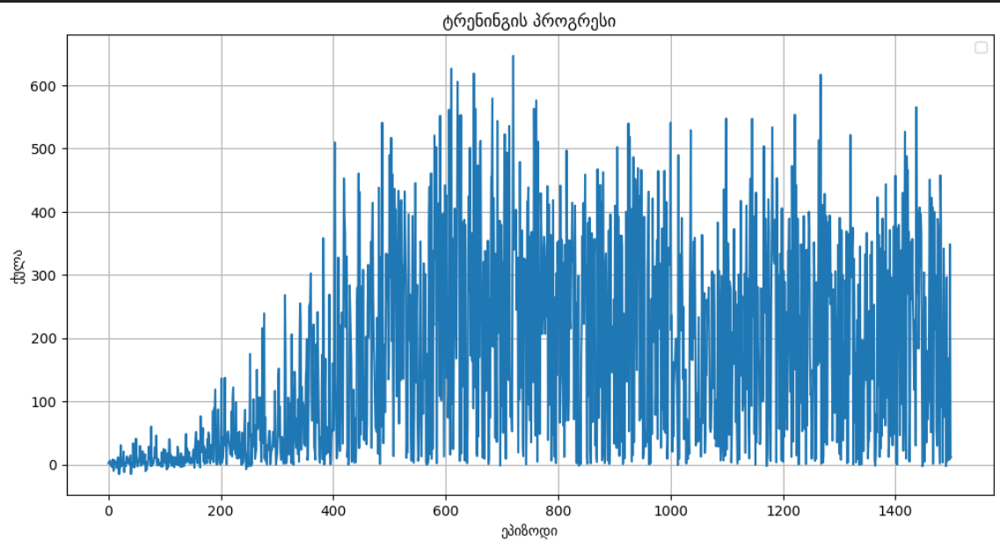

#### მეორე გაშვება

მეორე გაშვების დროს უკვე LEARING_RATE 10ჯერ შევამცირე და შედეგიც ბევრად უკეთესი იყო წინასთან შედარებით, მაქსიმალური ქულაც საკმაოდ გაიზარდა და საშუალოც, მაგრამ ჯერ–ჯერობით მაინც ისეთ შთაბეჭდილებას ტოვებდა, რომ უკეთესი შედეგის დადებაც შეეძლო.

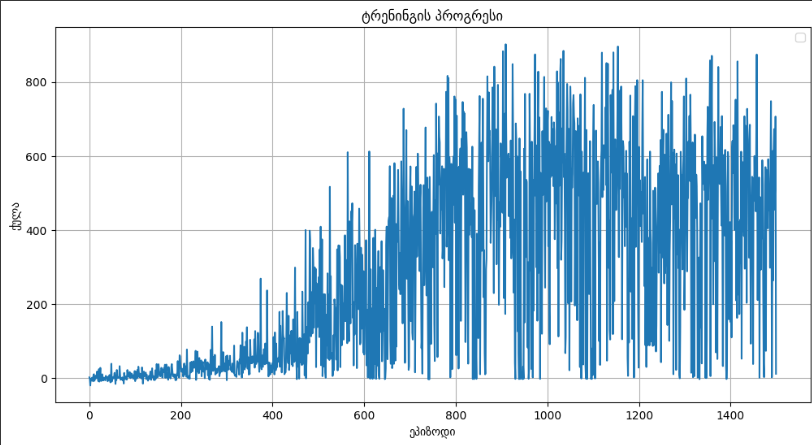

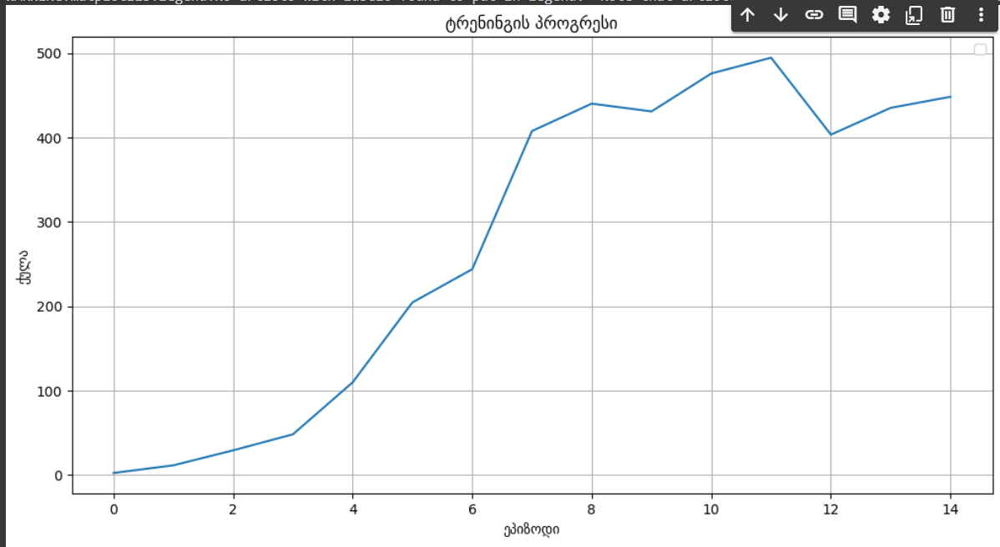

#### მესამე გაშვება

მეორე და მესამე პარალელურად მქონდა გაშვებული და განსხვავება მხოლოდ ის იყო, რომ მესამე გაშვებაში LEARNING_RATE 3ჯერ უფრო მცირე იყო ვიდრე მეორეში შედარებით უკეთესი შედეგი მივიღე და იგივე დასკვნა გავაკეთე ზუსტად, რომ გრაფიკით თუ ვიმსჯელებდით ვითარდებოდა კიდევ.

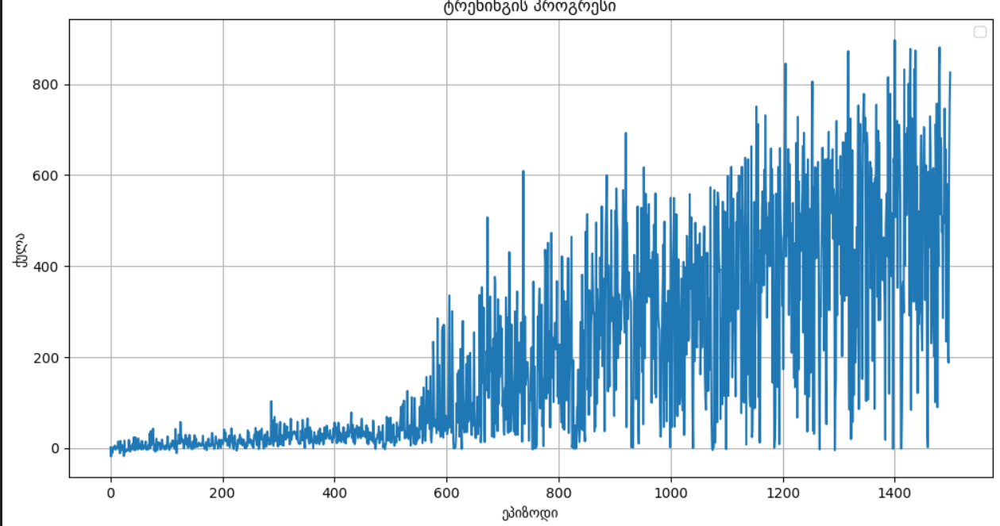

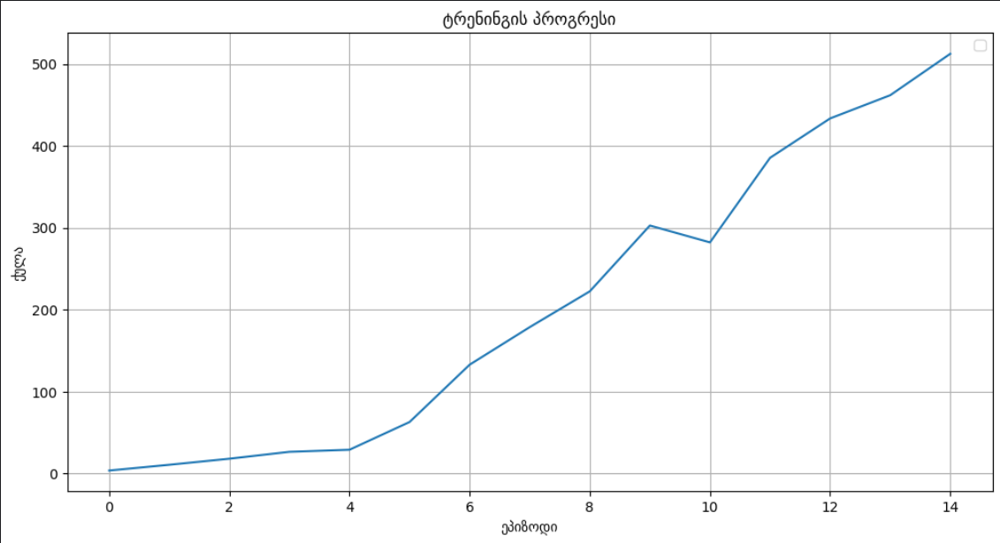

#### მეოთხე გაშვება

მეოთხე გაშვებაში უკვე გადავწყვიტე, რომ რაოდენობა გამეზარდა ეპიზოდების, რადგან ბოლო შედეგში გრაფიკი ისევ ზრდადი იყო და ასევე ისე ვქენი, რომ epsilon_decay გავანაწილე ისე, რომ epsilon min_epsilon ზუსტად ბოლო ეპიზოდზე გამხდარიყო. მაგრამ უკვე შეიძლება ზედმეტად რანდომად იცვლებოდა და შედარებით უფრო სტაბილური გახდა მოდელი რადგან ეგრე ძალიან არ დახტოდა ეპიზოდებს შორის, მაგრამ საშუალო უფრო ნელა იზრდებოდა და იმის მიუხედავად, რომ 500 მეტი ეპიზოდით იყო გაშვებული მაინც უფრო ნაკლებ მნიშვნელობაზე ავიდა.

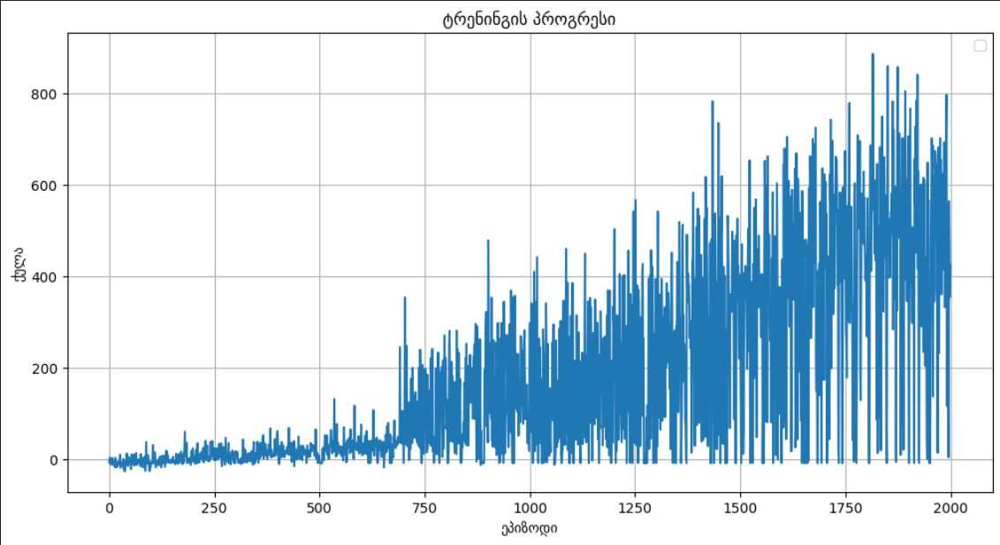

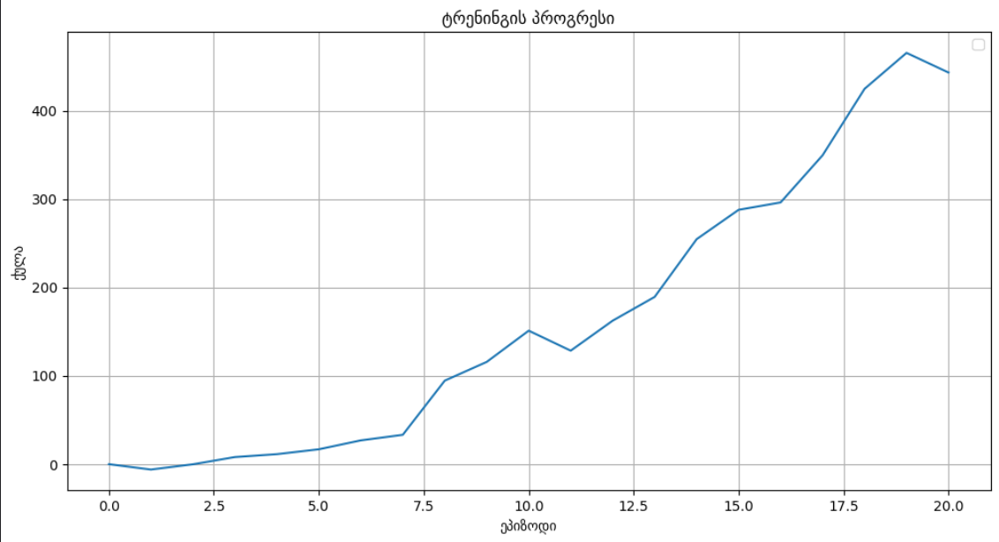

#### მეხუთე გაშვება

აქ კი ეფსილონი დავარეგულირე რომ ძალიან რანდომ ქცევებიც აღარ ჰქონოდა და 3000 ეპიზოდზე გავუშვი უკვე მოდელი, და ყველაზე კარგი მოდელი სწორად მან დადო.

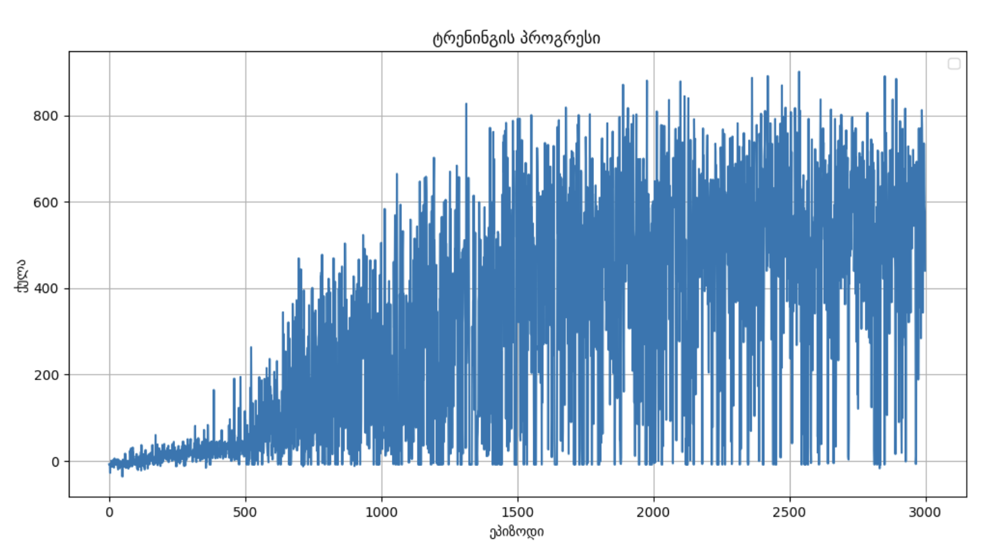

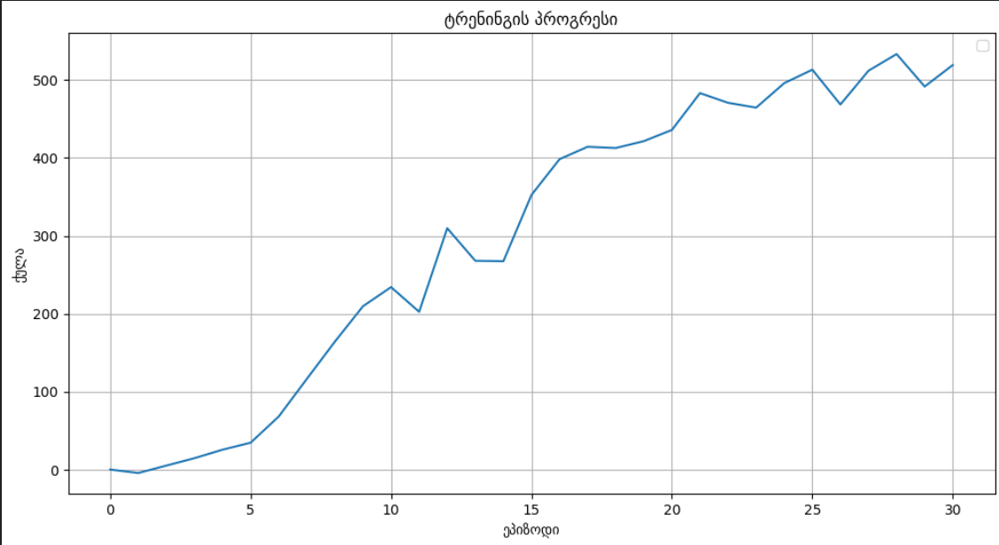

#### ჯამში

აღსანიშნავია, რომ მოცემული გრაფიკები არ აღწერას ზუსტად თუ რა ქულის აღება შეუძლია ჩვენს მოდელს, რადგან ის ხშირ რანდომად იქცევა და 10% ნაკლები არ მქონია არასდროს ეფსილონის მნიშვნელობა, მაგრამ ნელ–ნელა საშუალო უფრო იზრდებოდა და სტაბილური ხდებოდა მაგის მიუხედავად მოდელი. ერთი გაშვების გარდა ყველას მოდელი შენახული მაქვს თავისი გრაფიკებით აქ [მოდელები](https://drive.google.com/drive/folders/1mZKFjOdkZ-RZHg1N_fPZmYUkIquoe5O1?usp=sharing), (როგორც ვთქვი kaggleზე ვუშვებდი და მაშინ დაკომიტების გარეშე გავუშვი და სესიის დამთავრების გამო ვერ მოვახერხე, რომ შემენახა). უკეთ თუ როგორ მუშაობს კი გატესტვის დროს ვნახავთ, მაგრამ მიმაჩნია, რომ ტრენინგმა ნორმალურად ჩაიარა.

## ტესტინგი

### ტესტირებისთვის დამხმარე მეთოდები

In [23]:
def load_models(model_path, target_model_path, num_actions=NUM_ACTIONS):
    model = DQN(num_actions)
    model.load_state_dict(torch.load(model_path))
    model.eval()

    target_model = DQN(num_actions)
    target_model.load_state_dict(torch.load(target_model_path))
    target_model.eval()

    return model, target_model

### თვით ტესტინგი

In [24]:
def simulate_and_record(env, test_model, episode_duration=EPISODE_DURATION):
    state = env.reset()[0]
    score = 0
    for _ in range(episode_duration):
        state = filter_state(state, image_processor)
        action = test_model.choose_action(state, False)
        state, reward, done, a, _ = env.step(action)
        score += reward

        if done or a:
            break

    return score

def simulate_and_test(env_test, test_model):
    data = []
    for episode in range(1, TEST_EPISODE + 1):
        score = simulate_and_record(env_test, test_model)
        data.append(score)
        curr_time = datetime.now().strftime("%H:%M:%S")
        print(f"[{curr_time}] Episode {episode}/{TEST_EPISODE}, Total score: {score}")

    plot_scores(data)
    

In [25]:
# env_test = gym.make('CarRacing-v2', render_mode='human', continuous=False)

# q_network = DQN(NUM_ACTIONS)
# target_q_network = DQN(NUM_ACTIONS)
# model, target_model = load_models("/kaggle/input/1/pytorch/default/1/dqn_model_4.pth", "/kaggle/input/1/pytorch/default/1/dqn_target_model_4.pth")

# test_model = DQNAgent(q_network, target_q_network)
# test_model.q_network = model.to(device)
# test_model.target_q_network = target_model.to(device)

# simulate_and_test(env_test, test_model)

მოცემულ გრაფიკზე დაკვირვებით, შეგვიძლია ვთქვათ, რომ მანქანა ნორმალურად დადის მაგრამ ერთი პრობლემა აქვს. კერძოდ, ჩვენი ალგორითმის თანახმად თუ დიდი ხნის განმავლობაში იყო გზიდან გადასული ვამთავრებთ ეპიზოდს ვამთავრებთ, რის გამოც ეგეთ სიტუაციაში თუ მოხვდა როგორ მოიქცეს არ იცის და გაშვების დროს უმეტესად მაგ შემთხვევაში აფეილებს ხოლმე. სხვა ყველაფერს ნორმალურად აკეთებს და საშუალოდ 700 ქულას აგროვებს ხოლმე. შედეგის გაუმჯობესების ერთი ვარიანტი შეიძლება იყოს გზიდან გადასული რაოდენობის გაზრდა ან ეპიზოდების გაზრდა და დიდი ალბათობით ეს ყველაფერი უშველის ამას, რადგან აშკარად ბევრი რაღაცის სწავლა მოახერხა. მაგრამ ამ შემთხვევაში მირჩევნია, რომ მეორე ალგორითმზე გავაკეთო აქცენტი და მაგას დავაკვირდე, რადგან ეს ჩემი აზრით უკვე ნორმალურად მუშაობს და პლიუს უბრალოდ მეტ ეპიზოდზე გაშვებით გააუმჯობესებს ქმედებას.

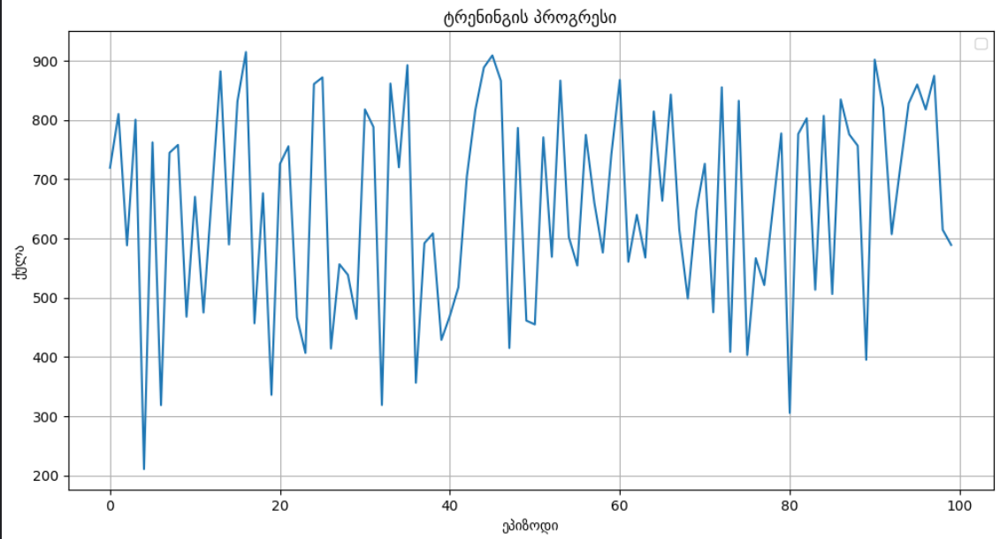

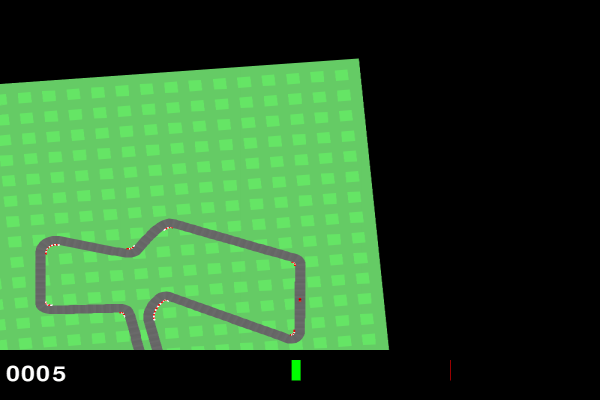

# მოდელი - Proximal Policy Optimization

თავდაპირველად ppo ალგორითმის ზოგადი მიმოხილვა გავაკეთოთ. მე პირადად თეორიულად ppoს კარგად გააზრებისთვის [წყარო](https://medium.com/@danushidk507/ppo-algorithm-3b33195de14a) გამომადგა, და მოკლედ შევეცდები შევაჯამო ეს ყველაფერი. ppo წინა მეთოდების საფუძველზე სწავლობს და ვითარდება და აბალანსებს სწავლას და გამოკოვლევას. ის შედგება რამდენიმე მნიშვნელოვანი ელემენტისგან. კერძოდ, policy function გვაქვს, რომლის საშუალებითაც აგენტი წყვეტს რა მოქმედება გააკეთოს და value function, რომელიც მოსალოდნელი მოგების შეფასებას ცდილობს. ppo ასევე updateის გაკეთების დროს ქვემოთ მოცემული ფუნქციის მაქსიმიზაციას ცდილობს, რათა სტაბილური იყოს მოდელი ისევ. 

**$L^{\text{CLIP}}(\theta) = \mathbb{E}_t \left[ \min \left( r_t(\theta) \hat{A}_t, \text{clip}\left(r_t(\theta), 1 - \epsilon, 1 + \epsilon\right) \hat{A}_t \right) \right]$**

ასევე, გვაქვს advantageები, რომლებიც აფასებს, თუ რამდენად უკეთესია მოქმედება value ფუნქციის მიერ დაბრუნებულ მნიშველობაზე. სხვა ყველაფერზე იმპლემენტაციის დროს უფრო ვილაპარაკებ და უკეთესად ავხსნი.


In [26]:
env = gym.make('CarRacing-v2', render_mode='rgb_array', continuous=True)

## იმპლემენტაცია

### ჰიპერპარამეტრები და კონსტანტები PPO–ისთვის

In [27]:
# Hyperparameters
STATE_SHAPE = (4, 96, 96)
NUM_ACTIONS = 3
LEARNING_RATE = 3e-4
DISCOUNT_FACTOR = 0.99
CLIP_EPSILON = 0.2
UPDATE_STEPS = 10
MAX_GRADIENT_NORM = 0.5
PPO_EPOCH = 4
BUFFER_CAPACITY = 2048
BATCH_SIZE = 64
GAMMA = 0.99
LAMBDA = 0.95
MAX_EPISODES = 3000
EPISODE_DURATION = 1000
N_LOG_EPISODE = 10
SKIP_FRAMES = 3
MAX_LOSING_STREAK = 35

### კადრების დასტაკვა

ეს ნაწილი ერთ–ერთი ბოლო რაღაცა იყო რაც დავამატე და წინა მოდელზეც საკმაოდ კარგად იმუშავება. მაქამდე 4 ნაბიჯს ერთად გადავდიოდი, მაგრამ არ ვაწვდიდი ნეირონულ ქსელს. ამ ყველაფრის შეცვლის მერე კი პერფორმანსი გაცილებით გაიზარდა, რაც საკმაოდ ლოგიკურია, კერძოდ იმიტომ, რომ მოძრაობა დინამიურია და მხოლოდ ერთი კადრით რა სიჩქარით მოძრაობს მაგისი თქმა რთულია, რის გამოც მოდელი რომ გავუშვი და დავაკვირდი თითქმის მაქსიმალური სიჩქარით მიდიოდა სულ და მოსახვევებში შესასვლელად მაგის გამო უწევდა, რომ გზიდან გადასულიყო, რის გამოც ქულებს კარგავდა და მერე დაბრუნებულიყო.

In [28]:
class FrameStack:
    def __init__(self, num_frames):
        self.num_frames = num_frames
        self.frames = deque(maxlen=num_frames)

    def push(self, frame):
        self.frames.append(frame)

    def get(self):
        while len(self.frames) < self.num_frames:
            self.frames.append(np.zeros_like(self.frames[0]))
        return np.concatenate(list(self.frames), axis=0)

### ActorCritic

CNN გვაქვს, როგორც წინა ქსელში, რომ სურათიდან ამოვიღოთ რაღაცა featureები ერთი განსხვავებით, ოთხი ჩენელი გვაქვს. გვაქვს ასევე alpha და beta პარამეტრები, რომლებიც ბეტა განაწილებიდან გვიბრუნებენ მოქმედებებს უწყვეტ action spaceში, რაც ჩვენთვის საჭიროა. v ცვლადი კიდევ აპრედიქტებს ახლანდელი მდგომარეობის მოგებას რასაც შემდეგ სწავლის შეფასებაში გამოვიყენებთ. თავდაპირველ წონებს xavierის საშუალებით ვაკეთებ, რადგან მოძიების მერე ვნახე, რომ პერფორმანსზე კარგად მოქმედებდა და მოდელს თავდაპირველად უჭირდა კარგად სწავლა. მეტი ინფორმაციისთვის იხილეთ [წყარო](https://www.geeksforgeeks.org/xavier-initialization/).

In [29]:
class Net(nn.Module):
    def __init__(self):
        super(Net, self).__init__()
        self.cnn_base = nn.Sequential(  # (4, 96, 96)
            nn.Conv2d(4, 32, kernel_size=8, stride=4),  # (32, 23, 23)
            nn.ReLU(),
            nn.Conv2d(32, 64, kernel_size=4, stride=2),  # (64, 10, 10)
            nn.ReLU(),
            nn.Conv2d(64, 64, kernel_size=3, stride=1),  # (64, 8, 8)
            nn.ReLU(),
            nn.AdaptiveAvgPool2d((1, 1))  # (64, 1, 1)
        )
        self.v = nn.Sequential(nn.Linear(64, 64), nn.ReLU(), nn.Linear(64, 1))
        self.fc = nn.Sequential(nn.Linear(64, 64), nn.ReLU())
        self.alpha_head = nn.Sequential(nn.Linear(64, 3), nn.Softplus())
        self.beta_head = nn.Sequential(nn.Linear(64, 3), nn.Softplus())
        self.apply(self._weights_init)

    @staticmethod
    def _weights_init(m):
        if isinstance(m, nn.Conv2d):
            nn.init.xavier_uniform_(m.weight, gain=nn.init.calculate_gain('relu'))
            nn.init.constant_(m.bias, 0.1)

    def forward(self, x):
        x = self.cnn_base(x)
        x = x.view(x.size(0), -1)
        v = self.v(x)
        x = self.fc(x)
        alpha = self.alpha_head(x) + 1
        beta = self.beta_head(x) + 1

        return (alpha, beta), v

### აგენტი

აგენტის იმპლემენტაციაზე რომ ვთქვათ, როგორც ხედავთ სამი მეთოდისგან შედგება და სამივეს ვიტყვი. მე როგორც ვნახე, experience replayის იშვიათად იყენებენ ხოლმე PPOს დასაწერად, მაგრამ რაღაცა მსგასვი მაინც საჭიროა, რადგან ppo update სულ არ ხდება და რაღაცა პირობა უნდა დაკმაყოფილდეს მაგისთვის, კერძოდ რაღაცა რაოდენობის გამოცდილება უნდა დაგროვდეს, სწორად მაგიტომ agentში ვინახავთ ამ ყველაფერს და agent მაშინ გამოიძახებს updateს როცა გაივსება. ასევე, პერფორმანსის გასაზრდელად და მოდელის მეტი სტაბილურობისთვის ვიყენებ რამდენიმე ხერხს:

1.   ppo updateის დროს კი KL–დივერგენციას ვიყენებ, რადგან ხშირად იყო მომენტები, როდესაც ძალიან დიდ ნახტომებს აკეთებდა მოდელი და მოძიების მერე ვნახე, რომ KL–დივერგენციის დამატება მოდელს უფრო სტაბილურს ხდის 
2.   იგივე მიზეზის გამო advantageებს ვუკეთებ ნორმალიზაციას.
3.   ასევე, გრადიენტს ვუკეთებ clipს რადგან, დიდი ნახტომები არ გააკეთოს გრადიენტმა.
4.   ენთროპიის კოეფიციენტი დავამატე, რომ უფრო სწავლა გაემჯუბესებინა.
5.   GAEს ვიყენებ, რომ bias და variance დააბალანსოს.

წერის დროს ეს პრობელემები მქონდა და დასერჩვის შედეგად ვნახე, რომ ამ პრობლემებს ესენი ასწორებდა და მართლაც გამოასწორა.


In [30]:
class Agent():
    def __init__(self):
        self.discount_factor = GAMMA
        self.gae_lambda = 0.95
        self.max_grad_norm = MAX_GRADIENT_NORM
        self.clip_param = CLIP_EPSILON
        self.ppo_epoch = PPO_EPOCH
        self.buffer_capacity = BUFFER_CAPACITY
        self.batch_size = BATCH_SIZE
        self.training_step = 0
        self.target_kl = 0.01
        self.kl_penalty = 0.0
        self.coef_entropy = 0.01
        self.frame_stack = FrameStack(4)
        self.net = Net().double().to(device)
        self.buffer = np.empty(self.buffer_capacity, dtype=np.dtype([
            ('state', np.float64, STATE_SHAPE),
            ('action', np.float64, (NUM_ACTIONS,)),
            ('a_logp', np.float64),
            ('reward', np.float64),
            ('next_state', np.float64, STATE_SHAPE),
            ('done', bool)
        ]))
        self.counter = 0
        self.optimizer = optim.Adam(self.net.parameters(), lr=LEARNING_RATE)

    def select_action(self, state):
        state = torch.from_numpy(state).double().to(device).unsqueeze(0)
        with torch.no_grad():
            alpha, beta = self.net(state)[0]
        dist = Beta(alpha, beta)
        action = dist.sample()
        a_logp = dist.log_prob(action).sum(dim=1)

        action = action.squeeze().cpu().numpy()
        a_logp = a_logp.item()
        return action, a_logp

    def store(self, transition):
        self.buffer[self.counter] = transition
        self.counter += 1
        if self.counter == self.buffer_capacity:
            self.counter = 0
            return True
        return False

    def compute_gae(self, rewards, values, next_values, dones):
        gae = 0
        returns = []
        for step in reversed(range(len(rewards))):
            delta = rewards[step] + self.discount_factor * next_values[step] * (1 - dones[step]) - values[step]
            gae = delta + self.discount_factor * self.gae_lambda * (1 - dones[step]) * gae
            returns.insert(0, gae + values[step])
        return returns

    def update(self):
        self.training_step += 1

        state = torch.tensor(np.array(self.buffer['state']), dtype=torch.double).to(device)
        action = torch.tensor(np.array(self.buffer['action']), dtype=torch.double).to(device)
        reward = torch.tensor(np.array(self.buffer['reward']), dtype=torch.double).to(device).view(-1, 1)
        next_state = torch.tensor(np.array(self.buffer['next_state']), dtype=torch.double).to(device)
        old_a_logp = torch.tensor(np.array(self.buffer['a_logp']), dtype=torch.double).to(device).view(-1, 1)
        done = torch.tensor(np.array(self.buffer['done']), dtype=torch.bool).to(device).view(-1, 1)

        with torch.no_grad():
            _, old_v = self.net(state)
            _, next_v = self.net(next_state)
        
        returns = self.compute_gae(reward.cpu().numpy(), 
                                   old_v.cpu().numpy(), 
                                   next_v.cpu().numpy(), 
                                   done.cpu().numpy())
        returns = torch.tensor(returns, dtype=torch.double).to(device).view(-1, 1)
        advantages = returns - old_v
        advantages = (advantages - advantages.mean()) / (advantages.std() + 1e-8)

        for _ in range(self.ppo_epoch):
            for index in BatchSampler(SubsetRandomSampler(range(self.buffer_capacity)), self.batch_size, False):
                (alpha, beta), new_v = self.net(state[index])
                dist = Beta(alpha, beta)
                a_logp = dist.log_prob(action[index]).sum(dim=1, keepdim=True)
                ratio = torch.exp(a_logp - old_a_logp[index])

                with torch.no_grad():
                    old_dist = Beta(alpha.detach(), beta.detach())
                    kl_div = torch.distributions.kl.kl_divergence(old_dist, dist).sum(dim=1, keepdim=True)

                surr1 = ratio * advantages[index]
                surr2 = torch.clamp(ratio, 1.0 - self.clip_param, 1.0 + self.clip_param) * advantages[index]
                action_loss = -torch.min(surr1, surr2).mean()
                value_loss = F.mse_loss(new_v, returns[index])
                entropy = dist.entropy().mean()

                loss = action_loss + 0.5 * value_loss - self.coef_entropy * entropy + self.kl_penalty * kl_div.mean()

                self.optimizer.zero_grad()
                loss.backward()
                nn.utils.clip_grad_norm_(self.net.parameters(), self.max_grad_norm)
                self.optimizer.step()

                kl_div_mean = kl_div.mean().item()
                if kl_div_mean > 1.5 * self.target_kl:
                    self.kl_penalty *= 2
                elif kl_div_mean < 0.5 * self.target_kl:
                    self.kl_penalty /= 2

        self.counter = 0

## ტრენინგი

ტრენინგის დროს ვიყენებთ dqnის დამხმარე მეთოდებს, რის გამოც ისინი მეორეჯერ აღარ აღვწერე. ასევე get_next_stateის გამოძახების დროს action ვამრავლებთ რაღაცაზე, რაც იმისთვისაა საჭირო, რომ გარემოსთვის შესაბამისი action_spaceის არგუმენტი გადავცეთ env.step(). დანარჩენი სტანდარტული ppoს ტრენინგის კოდია. ასევე, როგორც წინა პრობლემაში თუ გზიდან ძალიან გადაუხვია ვაჩერებ ეპიზოდს, მაგრამ წინა პრობლემების გამო გავზარდე რამდენის წაგება შეუძლია, მაგრამ სულ ამოშლა ალოგიკურია.

In [31]:
def train_ppo_episode(env, agent, image_processor, episode_duration):
    score = 0
    state = filter_state(env.reset()[0], image_processor)
    agent.frame_stack.push(state)
    stacked_state = agent.frame_stack.get()
    
    losing_streak = 0
    
    for _ in range(episode_duration):
        action, a_logp = agent.select_action(stacked_state)
        
        scaled_action = action * np.array([2., 1., 1.]) + np.array([-1., 0., 0.])
        
        next_state, reward, terminated, truncated, _ = get_next_state(state, scaled_action, image_processor)
        
        if reward >= 0:
            losing_streak = 0
        else:
            losing_streak += 1
            if losing_streak == MAX_LOSING_STREAK:
                truncated = True
        
        agent.frame_stack.push(next_state)
        next_stacked_state = agent.frame_stack.get()
        
        if agent.store((stacked_state, action, a_logp, reward, next_stacked_state, terminated or truncated)):
            agent.update()
        
        score += reward
        stacked_state = next_stacked_state
        
        if terminated or truncated:
            break
    
    return score

def train_ppo(env, agent, image_processor=ImageProcessor(None), max_episodes=MAX_EPISODES, episode_duration=EPISODE_DURATION):
    print("Training Model...")
    scores = []
    best_score = float('-inf')
    
    for episode in range(1, max_episodes + 1):
        score = train_ppo_episode(env, agent, image_processor, episode_duration)
        scores.append(score)
        
        avg_score = np.mean(scores[-100:])
        
        if avg_score > best_score:
            best_score = avg_score
            torch.save(agent.net.state_dict(), 'best_model.pth')
        
        curr_time = datetime.now().strftime("%H:%M:%S")
        print(f"[{curr_time}] Episode {episode}/{max_episodes}, Score: {score:.2f}, Avg Score: {avg_score:.2f}")
    
    print("Training complete...")
    return scores

ორი ძირათადი გაშვება მქონდა, დასტაკვით და დასტაკვის გარეშე და ორივე შემთხვევას ცალ–ცალკე გავარჩევ.

In [32]:
# agent = Agent()
# env = gym.make('CarRacing-v2', render_mode='rgb_array', continuous=True)
# scores = train_ppo(env, agent)
# plot_scores(scores)

### პირველი გაშვება

პირველი გაშვების დროს როგორც ვთქვი არ ვსტაკავდი კადრებს, რის გამოც სიჩქარის აღქმა არ ჰქონია. აქედან გამომდინარე, დასაწყისში საკმაოდ ცუდი შედეგი ჰქონდა, რის გამოც მეგონა რომ ალგორითმში მქონდა პრობლემა, მაგრამ უბრალოდ დავტოვე გაშვებული პროექტი და შევამჩნიე რომ ბოლოსკენ ზრდა დაიწყო (3000 ეპიზოდზე) რის გამოც კიდევ ერთხელ გავუშვი და ცუდი შედეგი არ დაუდია, კერძოდ საშუალოდ 720 ქულას იღებდა. მოდელის მთავარი პრობლემა ის იყო, რომ სიჩქარის აღქმა არ შეეძლო და სულ მაქსიმალური სიჩქარით ცდილობდა სიარულს, რის გამოც უცნაურად უხვევდა ხოლმე გზიდან გადადიოდა და მაგის გამო ქულებს კარგავდა, არადა მთლიან წრეს არტყავდა ხოლმე. მეტი პრობლემა არ ჰქონია.

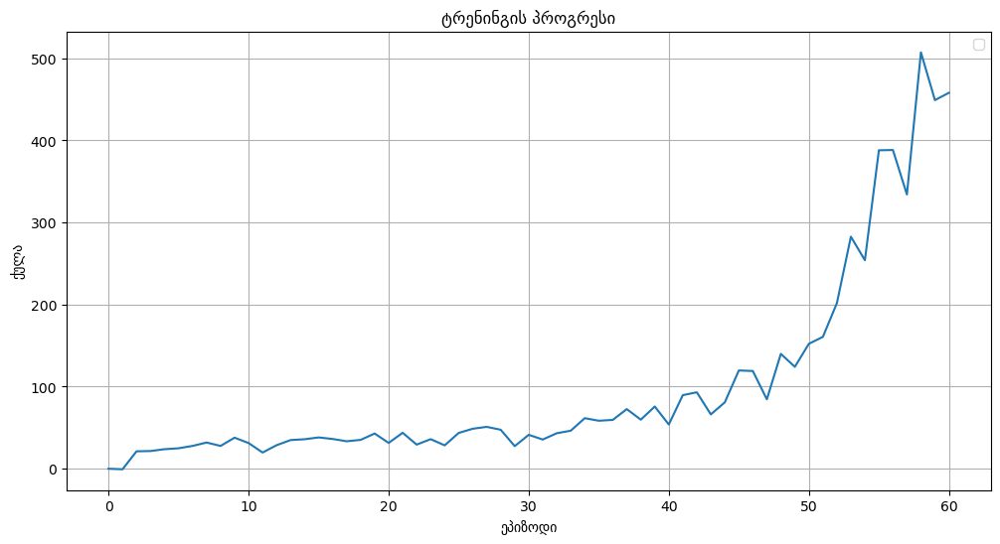

### მეორე გაშვება

მეორე ტრენინგის დროს, კი უკვე რომ ვსტაკავდით კადრებს ბევრად უფრო ჩქარა სწავლობდა და მალევე შეიმჩნეოდა პროგრესი. საბოლოო შედეგიც უფრო მაღალი მივიღეთ და ბევრად უფრო მალეც რაც საკმაოდ კარგია, ასევე 900 ქულაზე ხშირად ადიოდა ტრენინგის დროსაც კი. ის ყველა პრობლემა კი რაც წინა მოდელებს ჰქონდათ არ გვქონია და თითქმის იდეალურად დადის ტრეკზე მოცემული მანქანა და მივაღწიეთ სასურველ შედეგს.

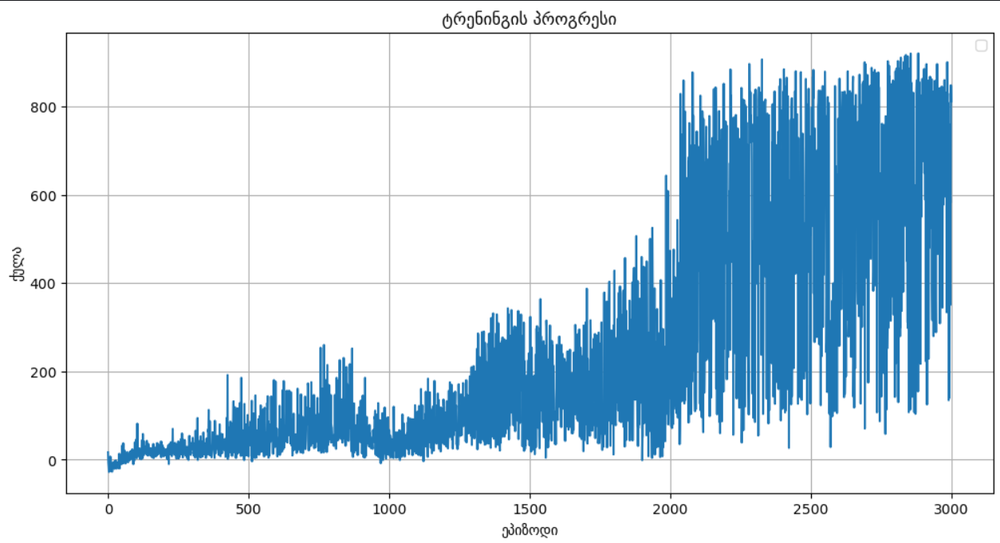

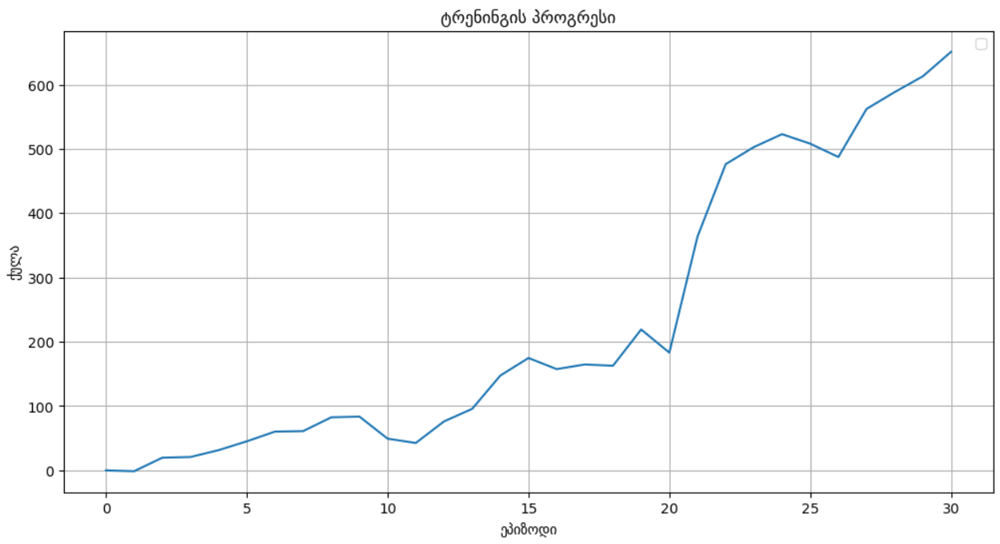

## ტესტინგი

### მოდელის დასეივების კოდი

In [33]:
# torch.save({
#             'net_state_dict': agent.net.state_dict(),
#         }, "a.pth")

### მოდელის ჩატვირთვის კოდი

In [34]:
# checkpoint = torch.load("a.pth")
# agent.net.load_state_dict(checkpoint['net_state_dict'])

# agent.net.eval()

In [35]:
def simulate_and_record(env, model, max_steps=1500):
    state = env.reset()[0]
    score = 0
    for step in range(max_steps):
        state = filter_state(state, image_processor)   
        action, _ = model.select_action(state)
        state, reward, done, _, _ = env.step(action * np.array([2., 1., 1.]) + np.array([-1., 0., 0.]))
        score += reward

        if done:
            print(f"Episode finished after {step} timesteps")
            break

    return score

def test_ppo(env_test, agent):
    scores = []
    for a in range(100):
        score = simulate_and_record(env_test, agent)
        scores.append(score)
        print(f"{a}     {score}")
    return scores

In [36]:
# env_test = gym.make('CarRacing-v2', render_mode='human', continuous=True)
# temp = test_ppo(env_test, agent)

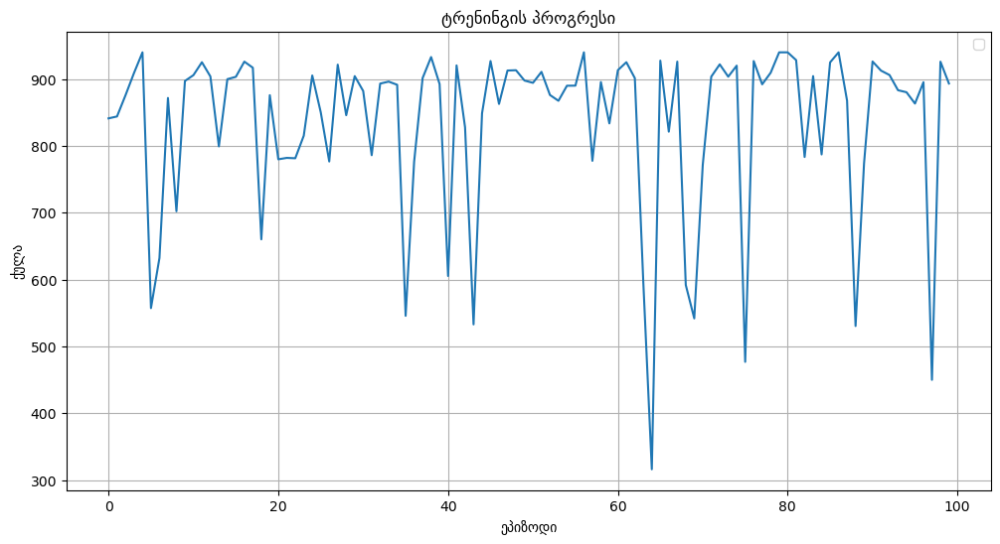

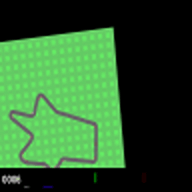

gifის ზომა პატარა იყო და რომ გავზარდე ხარისხი გაუფუჭდა.

საშუალოდ 835 ქულას იღებს, რაც საკმაოდ კარგი შედეგია.

# შეჯამება

ორი მოდელი განვხილე, dqn და ppo. dqnის წერის დროს ერთდაერთი რასაც შევცვლიდი ის არის, რომ კადრებს დასტაკავდი, რადგან მიმაჩნია, რომ უკეთესი შედეგის დადებას მოახერხებდა ის, მაგრამ მაგის მიუხედავად ცუდი შედეგი არ დაუდია მაინც, რადგან საშუალოდ 700 ქულის აღებას მაინც ახერხებდა ხოლმე. ppoს შემთხვევაში კი მიმაჩნია, რომ კარგად მუშაობს ის, რადგან საშუალოდ დაახლოებით 830 ქულას იღებს და დასაწერადაც ჩემთვის ბევრად რთული აღმოჩნდა და ბევრი ოპტიმიზაცია დავწერე და გადასწორება დამჭირდა, მაგრამ წერის დროს საკმაოდ ბევრი რაღაცა ვისწავლე. ამრიგად, მიმაჩნია, რომ მოცემულ ამოცანას კარგად უმკლავდება ppoს ალგორითმი.